In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        break

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/tuananhdataset/00004.png
/kaggle/input/face-detection-dataset/labels2/90cc772eb8d72107.txt
/kaggle/input/face-detection-dataset/labels/val/74c4898de45a904a.txt
/kaggle/input/face-detection-dataset/labels/train/90cc772eb8d72107.txt
/kaggle/input/face-detection-dataset/images/val/6e831b2533328828.jpg
/kaggle/input/face-detection-dataset/images/train/4d695bab03ca8a31.jpg


In [3]:
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.0/882.0 kB 19.4 MB/s eta 0:00:0000:01


In [4]:
import os
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import yaml
import math
import wandb
from ultralytics import YOLO
import random


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [5]:
# Define the paths to your train and val directories
train_dir = '/kaggle/input/face-detection-dataset/images/train'
val_dir = '/kaggle/input/face-detection-dataset/images/val'

# Function to count images in a directory
def count_images(directory):
    count = 0
    for root, dirs, files in os.walk(directory):
        for file in files:
            # Check if the file is an image file (adjust extensions as needed)
            if file.endswith('.jpg') or file.endswith('.png') or file.endswith('.jpeg'):
                count += 1
    return count

# Count images in the train and val directories
train_images_count = count_images(train_dir)
val_images_count = count_images(val_dir)

# Print the counts
print(f"Number of images in train directory: {train_images_count}")
print(f"Number of images in val directory: {val_images_count}")

Number of images in train directory: 13386
Number of images in val directory: 3347


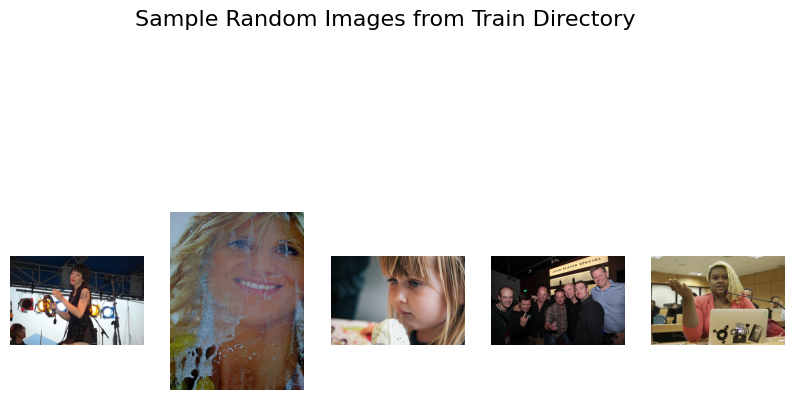

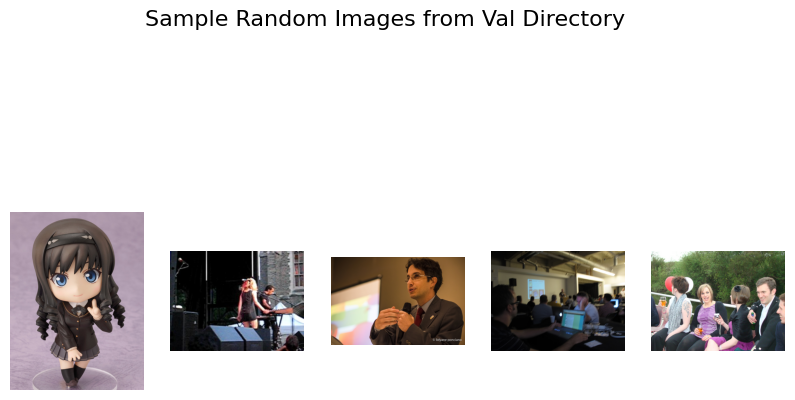

In [6]:
# Define the paths to your train and val directories
train_dir = '/kaggle/input/face-detection-dataset/images/train'
val_dir = '/kaggle/input/face-detection-dataset/images/val'

# Function to visualize random images from a directory
def visualize_random_images(directory, num_images=5):
    images_to_show = num_images
    fig = plt.figure(figsize=(10, 6))

    # List all image files in the directory
    all_files = []
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith('.jpg') or file.endswith('.png') or file.endswith('.jpeg'):
                img_path = os.path.join(root, file)
                all_files.append(img_path)

    # Shuffle the list of image paths
    random.shuffle(all_files)
    
    # Display random images
    for i in range(images_to_show):
        img_path = all_files[i]
        img = mpimg.imread(img_path)
        plt.subplot(1, images_to_show, i + 1)
        plt.imshow(img)
        plt.axis('off')

# Visualize random images in the train directory
visualize_random_images(train_dir)
plt.suptitle('Sample Random Images from Train Directory', fontsize=16)
plt.show()

# Visualize random images in the val directory
visualize_random_images(val_dir)
plt.suptitle('Sample Random Images from Val Directory', fontsize=16)
plt.show()

In [7]:
config_file = {
    'data':'/kaggle/input/face-detection-dataset',
    'train':'/kaggle/input/face-detection-dataset/images/train',
    'train_labels':'/kaggle/input/face-detection-dataset/labels/train',
    'val':'/kaggle/input/face-detection-dataset/images/val',
    'val_labels':'/kaggle/input/face-detection-dataset/labels/val',
    'names':['Human Face']
}

100%|██████████| 15.9M/15.9M [00:00<00:00, 112MB/s] 



image 1/1 /kaggle/input/tuananhdataset/00000.png: 480x640 2 persons, 45.5ms
Speed: 6.2ms preprocess, 45.5ms inference, 50.5ms postprocess per image at shape (1, 3, 480, 640)


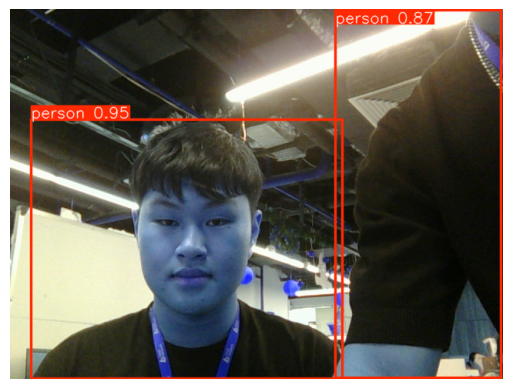

In [8]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt

# Load the pre-trained YOLOv5 model
model = YOLO('yolov10s.pt')

# Đường dẫn đến một ảnh trong tập dữ liệu của bạn
image_path = '/kaggle/input/tuananhdataset/00000.png'

# Run detection
results = model(image_path)

# Hiển thị kết quả
# results.show()

# Nếu muốn vẽ bounding box trên ảnh
image = cv2.imread(image_path)
result_img = results[0].plot()  # Kết quả của phát hiện

plt.imshow(result_img)
plt.axis('off')
plt.show()

In [9]:
with open('config_file.yaml', 'w') as file:
    yaml.dump(config_file, file, default_flow_style=False)

In [10]:
with open('/kaggle/working/config_file.yaml', 'r') as file:
    loaded_config = yaml.safe_load(file)

In [11]:
# Log in to Weights and Biases with your API key
wandb.login(key='48d20937623962bdd4988b153b55e970df4030dc')

wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [12]:
model.train(data='/kaggle/working/config_file.yaml', epochs=20)

Ultralytics 8.3.6 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov10s.pt, data=/kaggle/working/config_file.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True

100%|██████████| 755k/755k [00:00<00:00, 23.0MB/s]
2024-10-07 04:18:34,124	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-10-07 04:18:34,653	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1     36096  ultralytics.nn.modules.block.SCDown          [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1    137728  ultralytics

wandb: Currently logged in as: manh21082002. Use `wandb login --relogin` to force relogin


Freezing layer 'model.23.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLO11n...


100%|██████████| 5.35M/5.35M [00:00<00:00, 111MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/face-detection-dataset/labels/train... 13386 images, 0 backgrounds, 0 corrupt: 100%|██████████| 13386/13386 [00:56<00:00, 237.18it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/face-detection-dataset/labels is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/input/face-detection-dataset/labels/val... 3347 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3347/3347 [00:13<00:00, 248.22it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/face-detection-dataset/labels is not writeable, cache not saved.
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 99 weight(decay=0.0), 112 weight(decay=0.0005), 111 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      5.94G      3.144      3.809      2.616         56        640: 100%|██████████| 837/837 [05:39<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:28<00:00,  3.69it/s]

                   all       3347      10299      0.846      0.703      0.793      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      5.92G      2.742      1.824       2.28         53        640: 100%|██████████| 837/837 [05:29<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  3.93it/s]


                   all       3347      10299      0.862      0.733       0.82      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      5.94G      2.717      1.721      2.252         58        640: 100%|██████████| 837/837 [05:24<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  3.96it/s]


                   all       3347      10299       0.86      0.739      0.828      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      5.94G       2.68      1.659      2.231         74        640: 100%|██████████| 837/837 [05:22<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  3.94it/s]


                   all       3347      10299      0.852      0.771      0.843      0.545

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      6.03G      2.618      1.574      2.207         27        640: 100%|██████████| 837/837 [05:22<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  4.02it/s]


                   all       3347      10299      0.873      0.767      0.849      0.544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      5.84G      2.603      1.536      2.197         50        640: 100%|██████████| 837/837 [05:20<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.06it/s]


                   all       3347      10299      0.873      0.771      0.853      0.557

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      6.16G      2.563      1.501      2.178        105        640: 100%|██████████| 837/837 [05:20<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.04it/s]


                   all       3347      10299      0.882      0.782      0.862      0.558

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      6.02G      2.544      1.462      2.167         40        640: 100%|██████████| 837/837 [05:20<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.05it/s]


                   all       3347      10299      0.882       0.79      0.871      0.574

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      5.85G      2.522       1.43      2.164         48        640: 100%|██████████| 837/837 [05:20<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.09it/s]


                   all       3347      10299      0.873       0.79      0.868      0.569

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      6.18G      2.481      1.389      2.142         41        640: 100%|██████████| 837/837 [05:20<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.07it/s]


                   all       3347      10299      0.879      0.793      0.872      0.576
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      5.92G      2.462      1.302       2.15         21        640: 100%|██████████| 837/837 [05:19<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.05it/s]


                   all       3347      10299      0.882      0.787      0.869      0.572

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      5.94G      2.437      1.267      2.134         24        640: 100%|██████████| 837/837 [05:18<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  4.03it/s]


                   all       3347      10299      0.882      0.797      0.876      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      5.88G      2.417      1.238      2.122         19        640: 100%|██████████| 837/837 [05:17<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.07it/s]


                   all       3347      10299      0.871      0.805      0.875      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      5.85G      2.401      1.197      2.107         33        640: 100%|██████████| 837/837 [05:17<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.07it/s]


                   all       3347      10299      0.882      0.805      0.882      0.587

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      5.91G      2.369      1.167      2.098         25        640: 100%|██████████| 837/837 [05:17<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.06it/s]


                   all       3347      10299       0.89      0.793      0.884      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      5.91G      2.354      1.147      2.089         20        640: 100%|██████████| 837/837 [05:17<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.08it/s]


                   all       3347      10299       0.89        0.8      0.884      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      5.92G      2.337      1.115      2.083         21        640: 100%|██████████| 837/837 [05:18<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:25<00:00,  4.05it/s]


                   all       3347      10299      0.886      0.806      0.886      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      6.12G      2.321      1.093      2.068         25        640: 100%|██████████| 837/837 [05:18<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  4.01it/s]


                   all       3347      10299      0.894      0.804      0.889      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      5.91G      2.297      1.058      2.058         32        640: 100%|██████████| 837/837 [05:18<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  4.02it/s]


                   all       3347      10299      0.892      0.805      0.889      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      5.92G      2.275       1.04      2.054         34        640: 100%|██████████| 837/837 [05:18<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  4.00it/s]


                   all       3347      10299      0.888       0.81      0.889      0.598

20 epochs completed in 1.946 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 16.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 16.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.6 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv10s summary (fused): 293 layers, 8,035,734 parameters, 0 gradients, 24.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 105/105 [00:26<00:00,  3.94it/s]


                   all       3347      10299      0.887      0.811      0.889      0.598
Speed: 0.1ms preprocess, 4.0ms inference, 0.0ms loss, 0.1ms postprocess per image
Results saved to runs/detect/train


lr/pg0,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
lr/pg1,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
lr/pg2,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
metrics/mAP50(B),▁▃▄▅▅▅▆▇▆▇▇▇▇▇██████
metrics/mAP50-95(B),▁▃▄▅▅▅▆▆▆▇▆▇▇▇██████
metrics/precision(B),▁▃▃▂▅▅▆▆▅▆▆▆▅▆▇▇▇██▇
metrics/recall(B),▁▃▃▅▅▅▆▇▇▇▆▇██▇▇████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,█▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7eb160257010>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [13]:
directory_path = '/kaggle/working/runs/detect/train'  

# List the contents of the directory
directory_contents = os.listdir(directory_path)

# Display the contents of the directory
print("Contents of the directory:")
for item in directory_contents:
    print(item)

Contents of the directory:
F1_curve.png
train_batch8371.jpg
val_batch2_pred.jpg
val_batch2_labels.jpg
weights
R_curve.png
PR_curve.png
val_batch0_pred.jpg
events.out.tfevents.1728274727.b81f6ef79f9e.30.0
P_curve.png
val_batch1_pred.jpg
train_batch8370.jpg
train_batch2.jpg
labels_correlogram.jpg
val_batch1_labels.jpg
confusion_matrix_normalized.png
train_batch8372.jpg
val_batch0_labels.jpg
labels.jpg
train_batch1.jpg
confusion_matrix.png
results.png
train_batch0.jpg
results.csv
args.yaml


In [14]:
file_path = '/kaggle/working/runs/detect/train/args.yaml'

with open(file_path, 'r') as file:
    content = yaml.safe_load(file)

print(content)

{'task': 'detect', 'mode': 'train', 'model': 'yolov10s.pt', 'data': '/kaggle/working/config_file.yaml', 'epochs': 20, 'time': None, 'patience': 100, 'batch': 16, 'imgsz': 640, 'save': True, 'save_period': -1, 'cache': False, 'device': None, 'workers': 8, 'project': None, 'name': 'train', 'exist_ok': False, 'pretrained': True, 'optimizer': 'auto', 'verbose': True, 'seed': 0, 'deterministic': True, 'single_cls': False, 'rect': False, 'cos_lr': False, 'close_mosaic': 10, 'resume': False, 'amp': True, 'fraction': 1.0, 'profile': False, 'freeze': None, 'multi_scale': False, 'overlap_mask': True, 'mask_ratio': 4, 'dropout': 0.0, 'val': True, 'split': 'val', 'save_json': False, 'save_hybrid': False, 'conf': None, 'iou': 0.7, 'max_det': 300, 'half': False, 'dnn': False, 'plots': True, 'source': None, 'vid_stride': 1, 'stream_buffer': False, 'visualize': False, 'augment': False, 'agnostic_nms': False, 'classes': None, 'retina_masks': False, 'embed': None, 'show': False, 'save_frames': False, 's

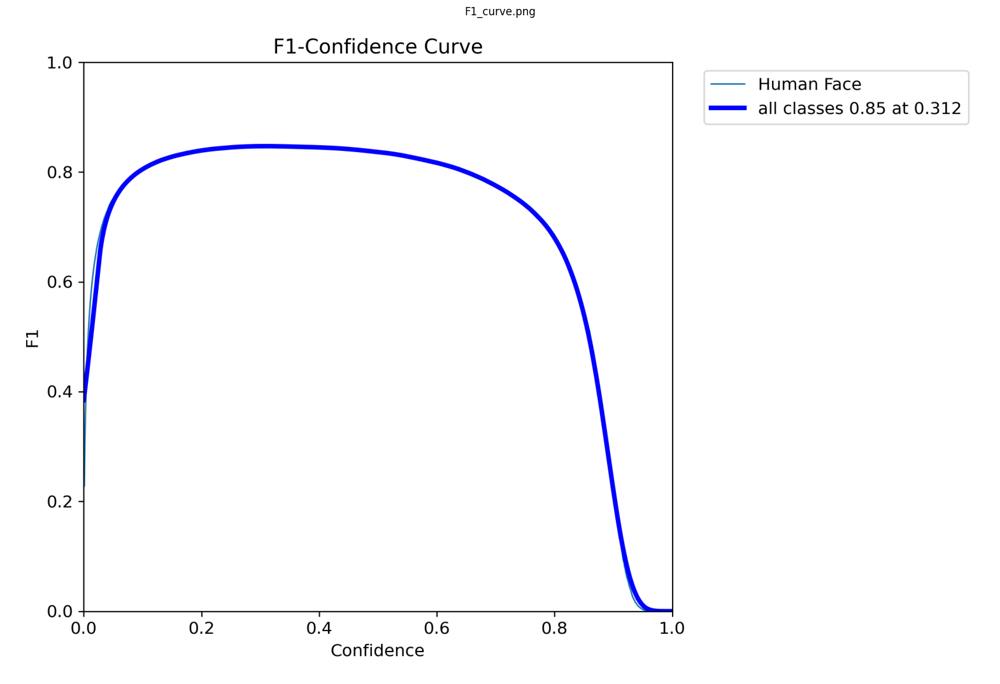

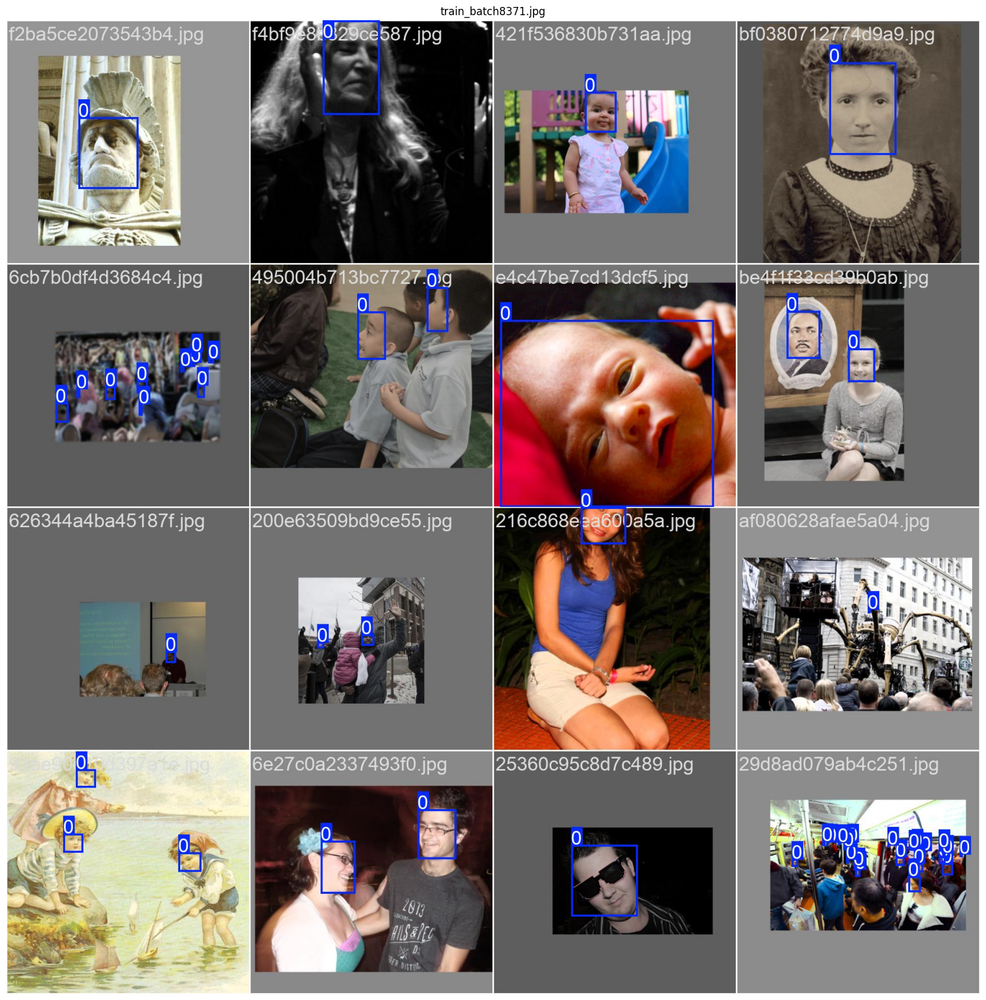

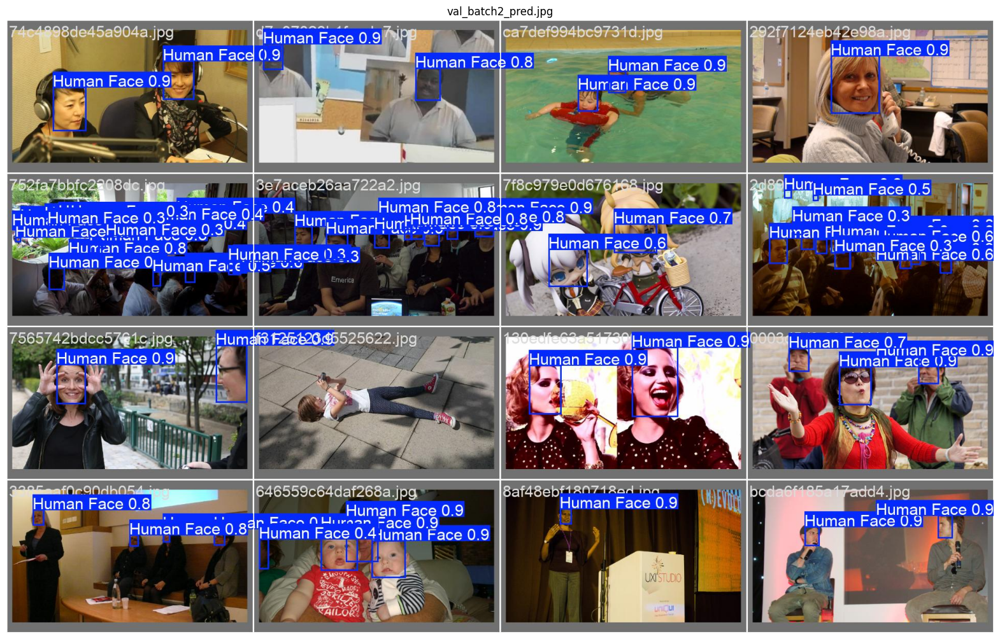

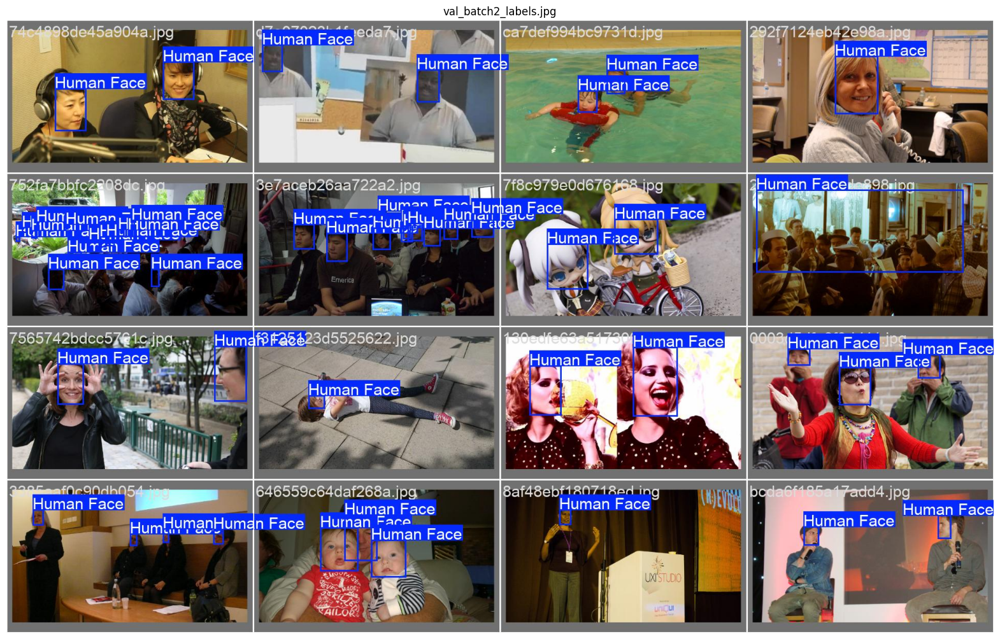

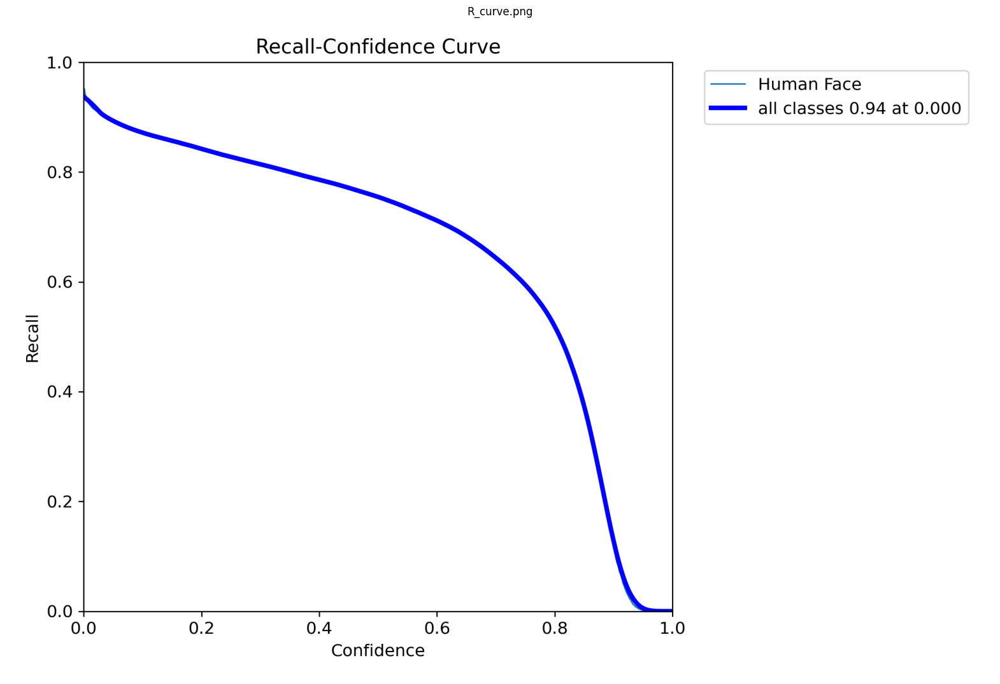

...

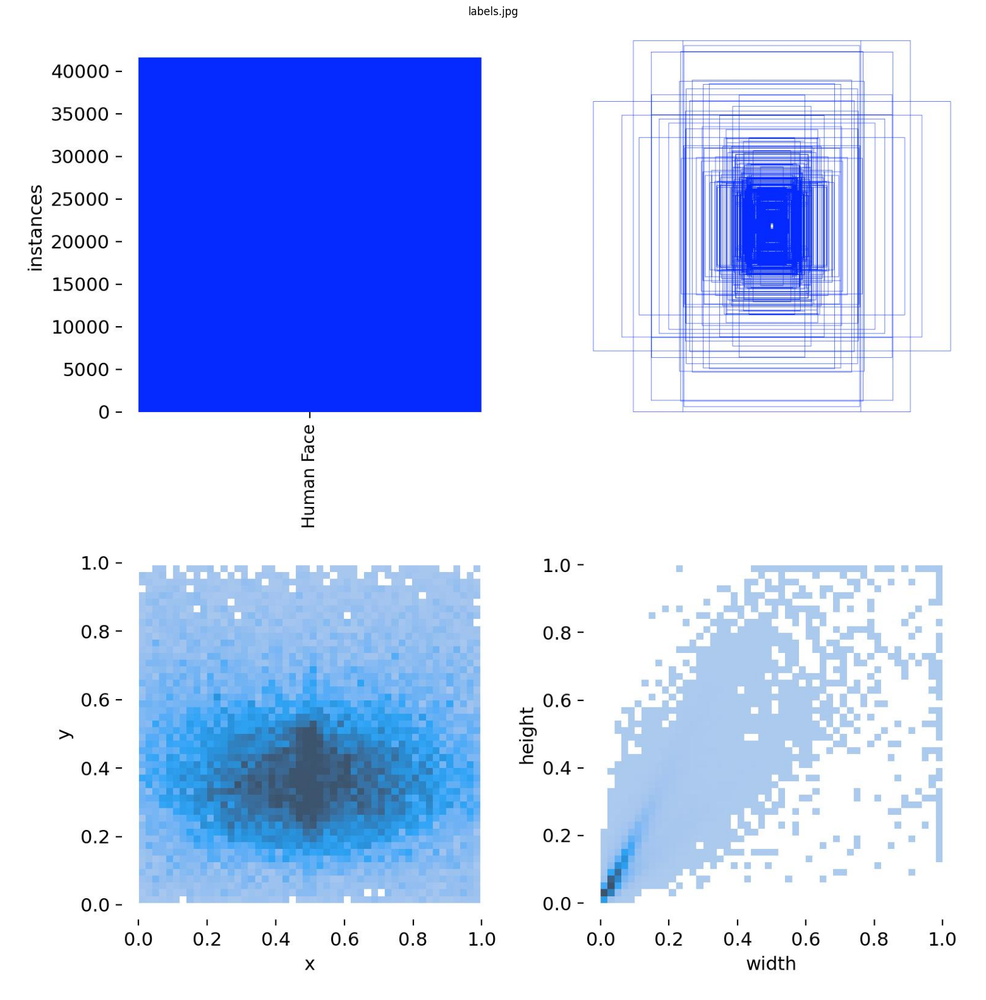

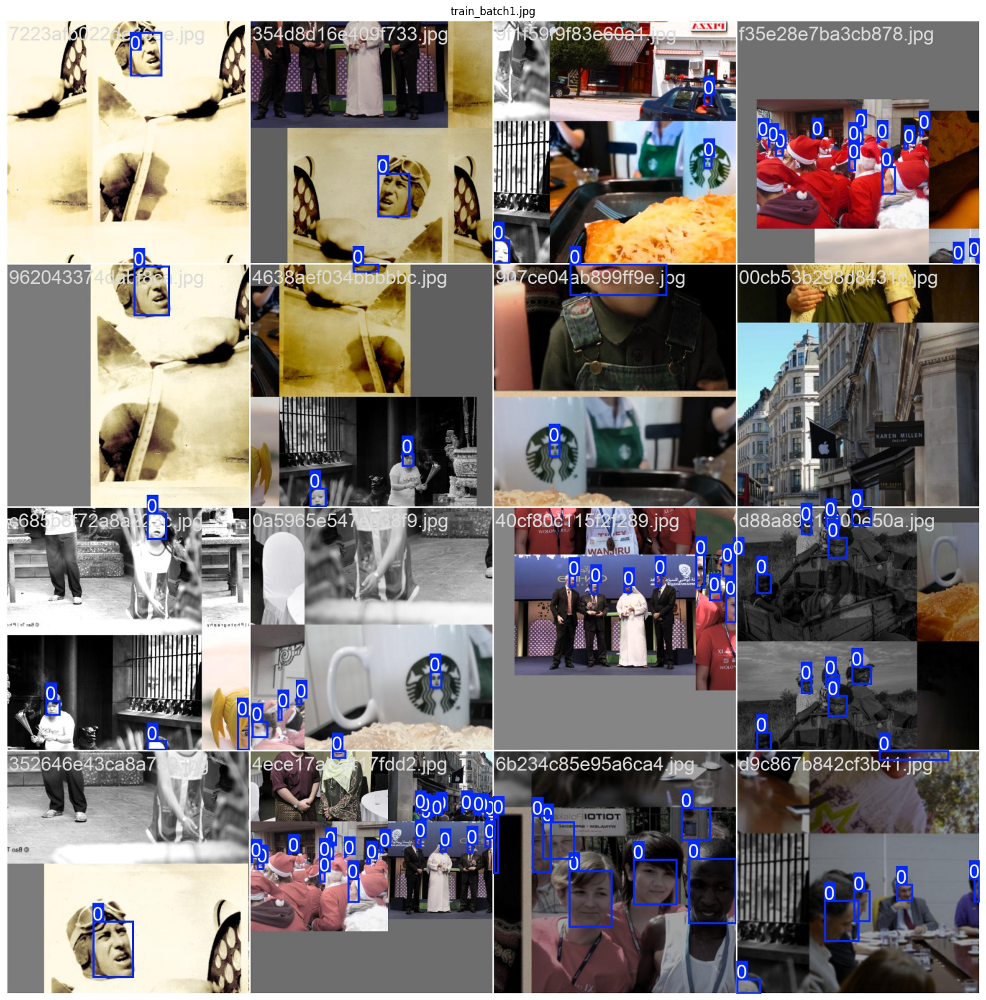

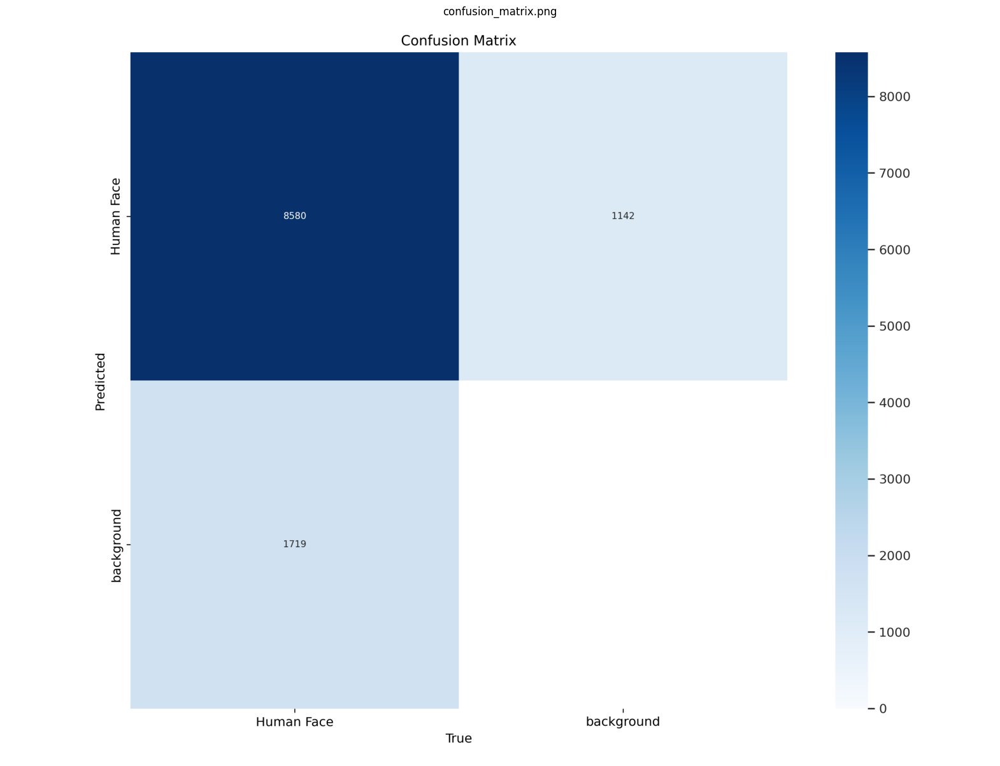

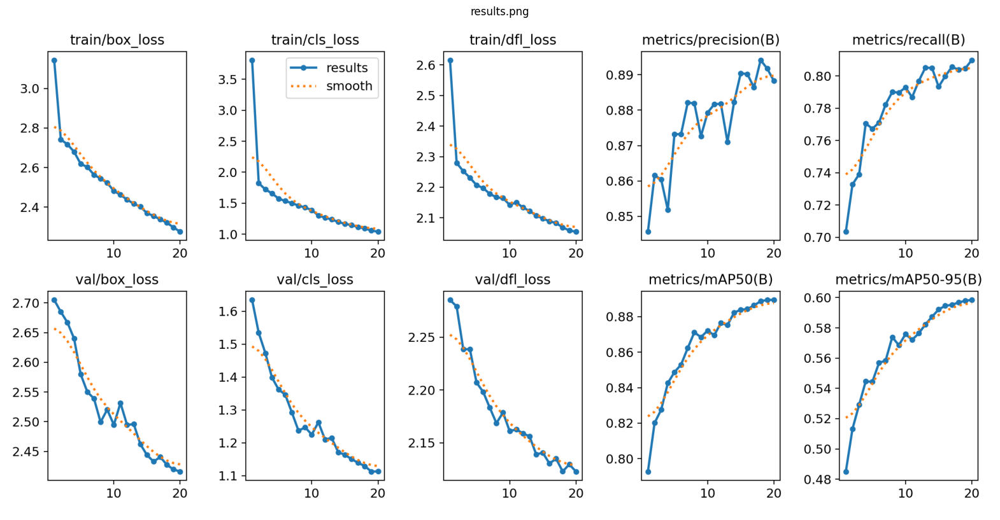

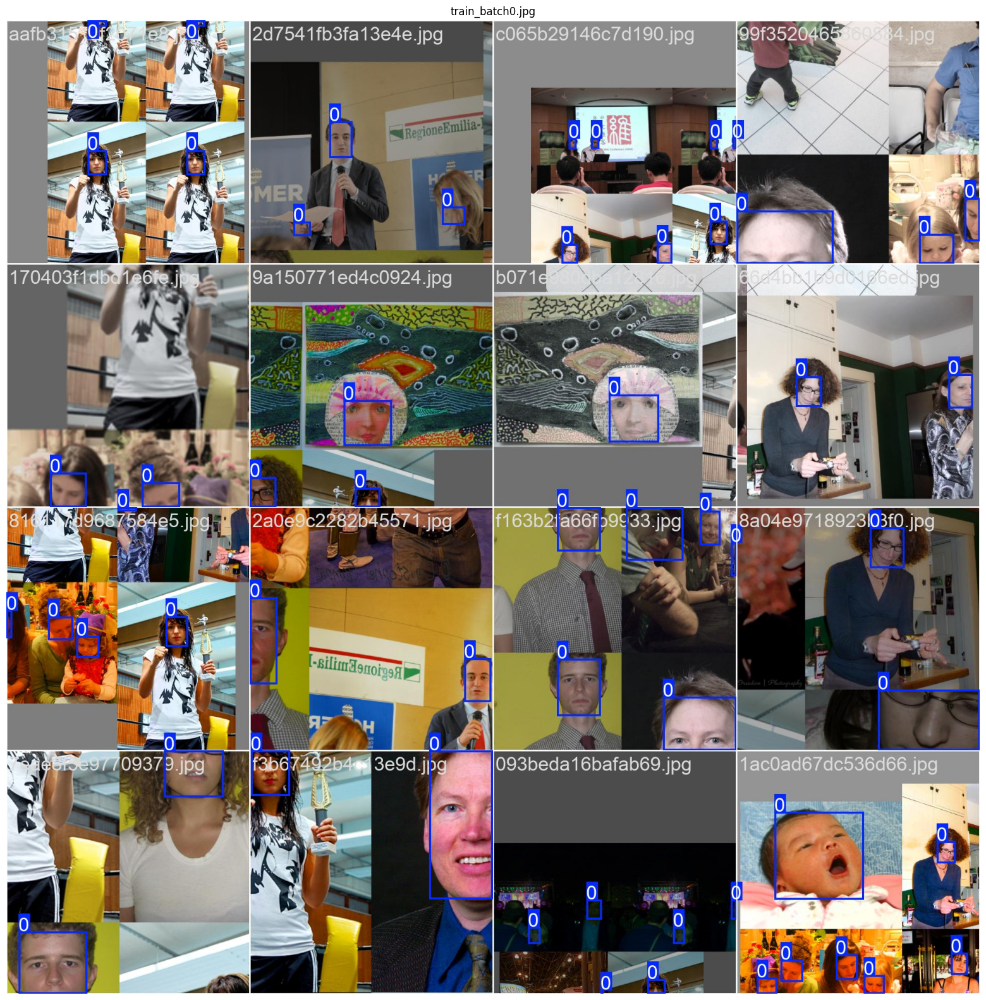

In [15]:
directory_path = '/kaggle/working/runs/detect/train'  

# Get a list of image files in the directory
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Visualize each image file
for img_file in image_files:
    img_path = os.path.join(directory_path, img_file)
    img = mpimg.imread(img_path)
    
    plt.figure(figsize=(20, 20))
    plt.imshow(img)
    plt.title(img_file)
    plt.axis('off')
    plt.show()

In [16]:
my_model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')

In [17]:
def draw_bbox(frame, boxes, colors):
    """
    Draws bounding boxes with labels on the input frame.

    Args:
        frame (numpy.ndarray): The input image frame.
        boxes (List[Object]): List of bounding boxes.
        class_names (List[str]): List of class names.
        colors (List[Tuple[int]]): List of RGB color values.

    Returns:
        None
    """
    for box in boxes:
        x1, y1, x2, y2 = box.xyxy[0]
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)

        # Extracting the class label and name
        cls = int(box.cls[0])
        class_name = "Face"

        # Retrieving the color for the class
        color = colors[cls]

        # Drawing the bounding box on the image
        cv2.rectangle(frame, (x1, y1), (x2, y2), color, 3)

        # Formatting the confidence level and label text
        conf = math.ceil((box.conf[0] * 100)) / 100
        label = f'{class_name} ({conf}%)'

        # Calculating the size of the label text
        text_size = cv2.getTextSize(label, 0, fontScale=1, thickness=2)[0]
        # Calculating the coordinates for the background rectangle of the label
        rect_coords = x1 + text_size[0], y1 - text_size[1] - 3

        # Drawing the background rectangle and the label text
        cv2.rectangle(frame, (x1, y1), rect_coords, color, -1, cv2.LINE_AA)
        cv2.putText(frame, label, (x1, y1 - 2), 0, 1, (255, 255, 255), thickness=1, lineType=cv2.LINE_AA)
    return frame

In [19]:
from IPython.display import FileLink

FileLink('runs/detect/train/weights/best.pt')

/kaggle/working/runs/detect/train/weights/best.pt


0: 480x640 1 Human Face, 47.9ms
Speed: 2.8ms preprocess, 47.9ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


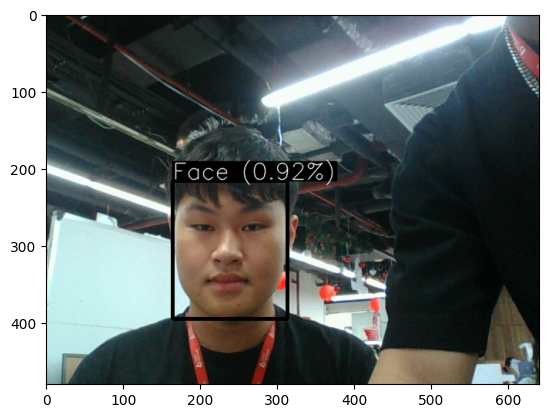

In [18]:
source = '/kaggle/input/tuananhdataset/00000.png'
frame = cv2.imread(source)
result = my_model(frame, conf=0.5)[0]
 
boxes = result.boxes
frame = draw_bbox(frame, boxes,  (0,255,255))
plt.imshow(frame[:,:,::-1])